# import library

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import datetime as dt
from statsmodels.tsa.seasonal import seasonal_decompose             # Time series components
from statsmodels.tsa.stattools import adfuller                      # To find the stationarity of the data
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf       # To plot ACF and PACF plots
from statsmodels.tsa.arima.model import ARIMA                       # To build the ARIMA model
from sklearn.metrics import mean_squared_error                      # To check the mean square error                                      
from statsmodels.tsa.statespace.sarimax import SARIMAX              # To build the sarimax model 
import statsmodels.api as sm                                 
import warnings
warnings.filterwarnings('ignore')

In [2]:
magzine=pd.read_csv('magzine_cleandata22.csv')#read data

In [3]:
magzine.head() #top five

,Unnamed: 0.1,Unnamed: 0,overall,verified,reviewTime,reviewerID,asin,reviewerName,style,category,title,also_buy,brand,also_view,main_cat,Review,polarity,Sentiment
0,0,0,3,False,2007-03-24,A3JPFWKS83R49V,B00005N7OJ,Bryan Carey,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,antique magazine publication antique lover his...,0.131140,Positive
1,1,2,5,False,2006-11-10,A19FKU6JZQ2ECJ,B00005N7OJ,Patricia L. Porada,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,beautiful magazine work art quality page bit i...,0.783333,Positive
2,2,4,5,True,2015-08-23,A2T0GO5G3JJ66V,B00005N7OJ,Helen C. Kuzmier,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,magazine work artgreat photography superb inte...,0.562500,Positive
3,3,6,3,True,2015-03-10,A1CEG4HICKGHUW,B00005N7OJ,Cliffton K. Bryner,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,ok star,0.500000,Positive
4,4,8,3,True,2015-01-04,AJW4UJUSJVKJA,B00005N7OJ,Christine Moran,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,nice look way highbrow not renew subscription ...,0.533333,Positive


In [4]:
magzine.drop(['Unnamed: 0','Unnamed: 0.1'],axis=1,inplace=True)# drop unnamed column

In [5]:
magzine2 = magzine[["Sentiment","Review"]]
magzine2.groupby('Sentiment').describe()

Review                                                            \
           count unique                                                top   
Sentiment                                                                    
Negative    4823   4747  grandchild get magazine cricket ladybug stage ...   
Neutral     6949   5335                                     greatfive star   
Positive   36795  34046                            great magazinefive star   

                
          freq  
Sentiment       
Negative     6  
Neutral    240  
Positive   324

In [6]:
magzine.shape

(48568, 16)

In [7]:
magzine.isnull().sum() #check null value

overall         0
verified        0
reviewTime      0
reviewerID      0
asin            0
reviewerName    1
style           0
category        0
title           0
also_buy        0
brand           0
also_view       0
main_cat        0
Review          1
polarity        0
Sentiment       0
dtype: int64

In [8]:
magzine.dropna(inplace=True)#drop null value

#### Convert the reviewTime column to a datetime format:

In [9]:
magzine['reviewTime'] = pd.to_datetime(magzine['reviewTime'])

In [10]:
magzine.dtypes#check datatypes

overall                  int64
verified                  bool
reviewTime      datetime64[ns]
reviewerID              object
asin                    object
reviewerName            object
style                   object
category                object
title                   object
also_buy                object
brand                   object
also_view               object
main_cat                object
Review                  object
polarity               float64
Sentiment               object
dtype: object

# Sentiment Forcasting

## sentiment forecasting using time series analysis can provide valuable insights into customer sentiment trends and help businesses make informed decisions to improve customer satisfaction and loyalty.

#### Convert the reviewTime column to a datetime format:

In [11]:
df=magzine.copy()
df.head(1)

,overall,verified,reviewTime,reviewerID,asin,reviewerName,style,category,title,also_buy,brand,also_view,main_cat,Review,polarity,Sentiment
0,3,False,2007-03-24,A3JPFWKS83R49V,B00005N7OJ,Bryan Carey,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,antique magazine publication antique lover his...,0.13114,Positive


In [12]:
df.dtypes

overall                  int64
verified                  bool
reviewTime      datetime64[ns]
reviewerID              object
asin                    object
reviewerName            object
style                   object
category                object
title                   object
also_buy                object
brand                   object
also_view               object
main_cat                object
Review                  object
polarity               float64
Sentiment               object
dtype: object

In [13]:
df.isnull().sum()

overall         0
verified        0
reviewTime      0
reviewerID      0
asin            0
reviewerName    0
style           0
category        0
title           0
also_buy        0
brand           0
also_view       0
main_cat        0
Review          0
polarity        0
Sentiment       0
dtype: int64

In [14]:
# Setting the index as Date
df= df.set_index('reviewTime')
df.head()

,overall,verified,reviewerID,asin,reviewerName,style,category,title,also_buy,brand,also_view,main_cat,Review,polarity,Sentiment
reviewTime,,,,,,,,,,,,,,,
2007-03-24,3,False,A3JPFWKS83R49V,B00005N7OJ,Bryan Carey,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,antique magazine publication antique lover his...,0.131140,Positive
2006-11-10,5,False,A19FKU6JZQ2ECJ,B00005N7OJ,Patricia L. Porada,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,beautiful magazine work art quality page bit i...,0.783333,Positive
2015-08-23,5,True,A2T0GO5G3JJ66V,B00005N7OJ,Helen C. Kuzmier,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,magazine work artgreat photography superb inte...,0.562500,Positive
2015-03-10,3,True,A1CEG4HICKGHUW,B00005N7OJ,Cliffton K. Bryner,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,ok star,0.500000,Positive
2015-01-04,3,True,AJW4UJUSJVKJA,B00005N7OJ,Christine Moran,Format Print Magazine,"['Magazine Subscriptions', 'Home & Garden', 'A...","<span class=""a-size-medium a-color-secondary""","['B0009793AC', 'B0045VPFC8', 'B001THPA44', 'B0...",Brant Publications,"['B0047VIAE6', 'B0000VBS8C', 'B0009793AC', 'B0...",Magazine Subscriptions,nice look way highbrow not renew subscription ...,0.533333,Positive


In [15]:
positive=df[(df['Sentiment']=='Positive')]
negative=df[(df['Sentiment']=='Negative')]
neutral=df[(df['Sentiment']=='Neutral')]

In [16]:
pos_df=positive[['polarity']]
pos_df

,polarity
reviewTime,
2007-03-24,0.131140
2006-11-10,0.783333
2015-08-23,0.562500
2015-03-10,0.500000
2015-01-04,0.533333
...,...
2017-05-06,0.156818
2017-01-31,0.375000
2017-06-19,0.070486


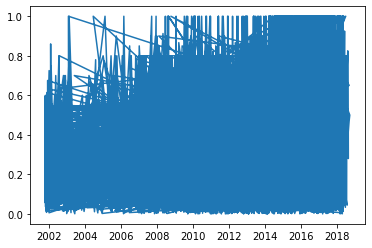

In [17]:
plt.plot(pos_df);

In [18]:
pos_df= pos_df.resample('MS').mean()
pos_df.isnull().sum()

polarity    0
dtype: int64

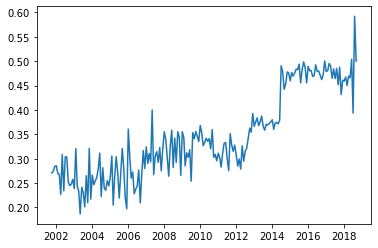

In [19]:
plt.plot(pos_df);

In [20]:
pos_df["polarity"] = pos_df["polarity"].interpolate(option="spline")

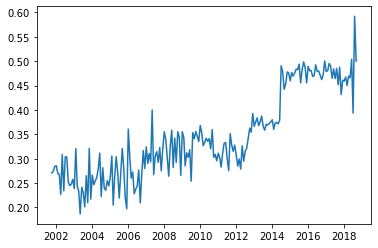

In [21]:
plt.plot(pos_df);

In [22]:
def check_data(data):
    pvalue = adfuller(data)[1]
    print("pvalue",pvalue)
    if pvalue < 0.05:
        msg = "Data is stationary"
    else:
        msg = "Data is not stationary"
    return msg

In [23]:
check_data(pos_df)

pvalue 0.9496826775117377


'Data is not stationary'

In [24]:
for i in range(1,5):
    x = pos_df-pos_df.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 1.0631533630923638e-12
Shift value 1 Data is stationary


In [25]:
# Decomposition plot for predicted data using Features
decomposition_p=seasonal_decompose((pos_df), period=12)
trend=decomposition_p.trend
seasonal=decomposition_p.seasonal
residual=decomposition_p.resid

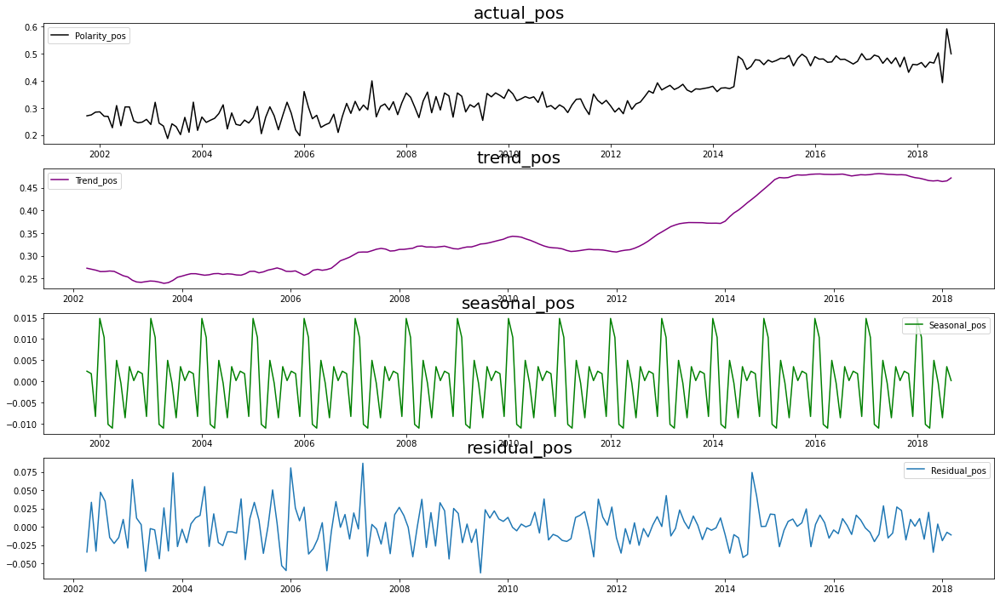

In [26]:
ig,ax = plt.subplots(4,1,figsize=(20,12))

plt.subplot(411)
plt.plot(pos_df,label='Polarity_pos',c='black')
plt.legend()
plt.title('actual_pos', fontsize = 20)

plt.subplot(412)
plt.plot(trend,label='Trend_pos',c='purple')
plt.legend()
plt.title('trend_pos', fontsize = 20)

plt.subplot(413)
plt.plot(seasonal,label='Seasonal_pos',c='green')
plt.legend()
plt.title('seasonal_pos', fontsize = 20)

plt.subplot(414)
plt.plot(residual,label='Residual_pos')
plt.legend()
plt.title('residual_pos', fontsize = 20)
plt.show()

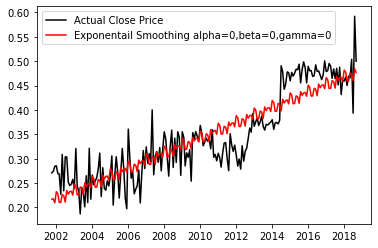

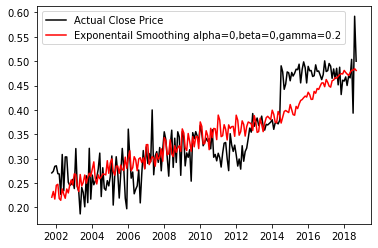

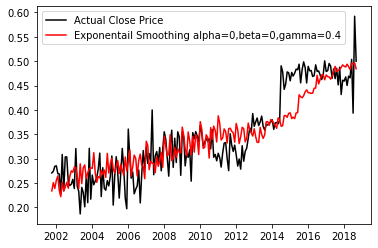

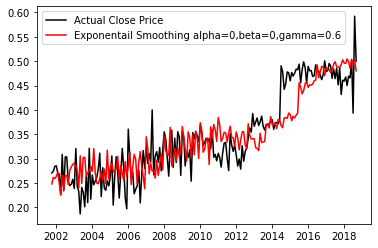

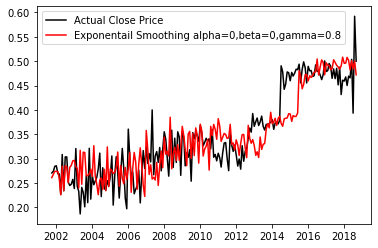

...

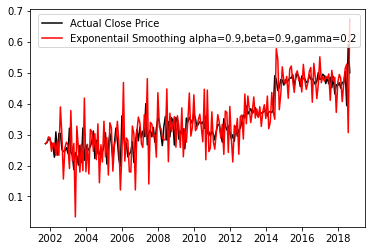

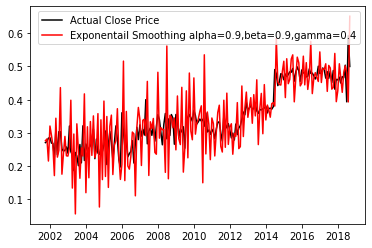

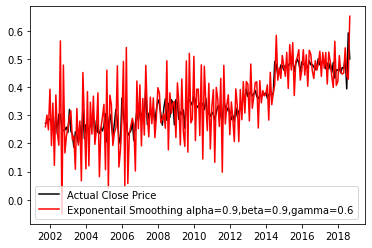

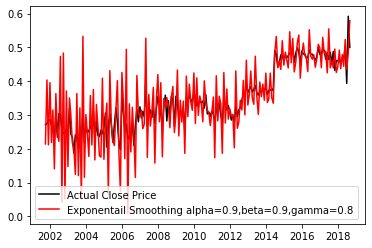

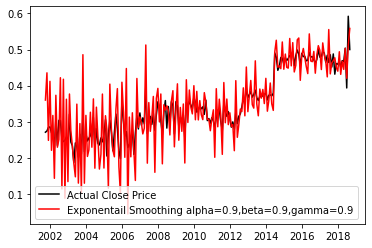

In [27]:
from statsmodels.tsa.api import ExponentialSmoothing
for alpha in [0,0.2,0.4,0.6,0.8,0.9]:
    for beta in [0,0.2,0.4,0.6,0.8,0.9]:
        for gamma in [0,0.2,0.4,0.6,0.8,0.9]:
            model = ExponentialSmoothing(pos_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
            plt.plot(pos_df,color='black',label="Actual Close Price")
            plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
            plt.legend()
            plt.show();

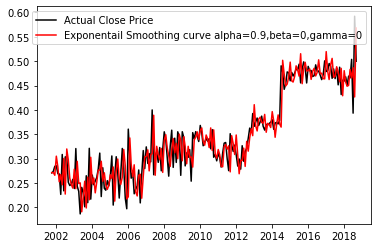

In [28]:
alpha = 0.9
beta = 0
gamma = 0
model = ExponentialSmoothing(pos_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
plt.plot(pos_df,color='black',label="Actual Close Price")
plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing curve alpha={alpha},beta={beta},gamma={gamma}')
plt.legend()
plt.show();

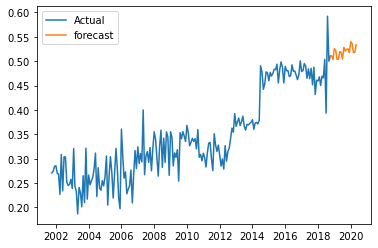

In [29]:
cd = model.forecast(20)
bx = pos_df["polarity"].append(cd[0:1])
plt.plot(bx,label="Actual")
plt.plot(cd,label="forecast")
plt.legend();

In [30]:
check_data(model.fittedvalues)

pvalue 0.9470456163434433


'Data is not stationary'

In [31]:
for i in range(1,5):
    x = model.fittedvalues-model.fittedvalues.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 3.589754250637487e-20
Shift value 1 Data is stationary


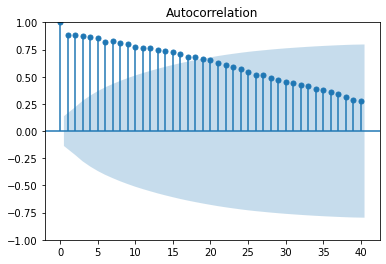

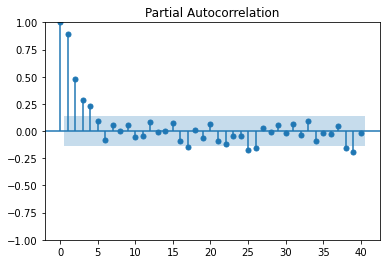

In [32]:
plot_acf(model.fittedvalues,lags=40)
plot_pacf(model.fittedvalues,lags=40);

In [33]:
for p in range(1,16):
    for q in range(1,8):
        mod = sm.tsa.statespace.SARIMAX(model.fittedvalues,order=(p,1,q),seasonal_order=None).fit()
        print("for ", p , q, mod.aic)

for  1 1 -837.8068871056985
for  1 2 -837.0050604182704
for  1 3 -834.8102960717194
for  1 4 -833.8146180634042
for  1 5 -832.4413416693862
for  1 6 -833.7517184618432
for  1 7 -832.1747730137959
for  2 1 -836.8835766662423
for  2 2 -835.7282560542706
for  2 3 -833.4088049053912
for  2 4 -833.0238152119498
for  2 5 -833.2997235488783
for  2 6 -832.0868967399063
for  2 7 -829.6031748150278
for  3 1 -837.0603035047191
for  3 2 -835.4479159699522
for  3 3 -833.4563106822825
for  3 4 -831.4082421314976
for  3 5 -832.1994922093244
for  3 6 -829.7205297779058
for  3 7 -828.0402060143269
for  4 1 -838.6733850084597
for  4 2 -833.5996624820978
for  4 3 -834.7283100437703
for  4 4 -832.5944197217736
for  4 5 -829.2440054560745
for  4 6 -830.6591318906414
for  4 7 -829.78492858974
for  5 1 -836.109359722693
for  5 2 -834.8987113622875
for  5 3 -831.873436575092
for  5 4 -830.712555499935
for  5 5 -829.1898986185748
for  5 6 -830.7587634590267
for  5 7 -827.9601974930811
for  6 1 -834.24260073897

In [34]:
rows = int(0.8*len(model.fittedvalues))
po_trn = pos_df[:rows]
po_tst = pos_df[rows:]

In [35]:
pop_mod = sm.tsa.statespace.SARIMAX(po_trn,order=(10,1,1),seasonal_order=(1,1,1,20)).fit()
pp_model = pop_mod.fittedvalues
print(pop_mod.summary())

                                      SARIMAX Results                                      
Dep. Variable:                            polarity   No. Observations:                  163
Model:             SARIMAX(10, 1, 1)x(1, 1, 1, 20)   Log Likelihood                 267.576
Date:                             Mon, 03 Apr 2023   AIC                           -507.151
Time:                                     09:44:45   BIC                           -465.769
Sample:                                 10-01-2001   HQIC                          -490.335
                                      - 04-01-2015                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1550      1.250     -0.124      0.901      -2.605       2.295
ar.L2         -0.2034      

In [36]:
pp_str = len(po_trn)
pp_end = len(po_trn)+(len(po_tst)-1)

In [37]:
pvalue = sm.stats.acorr_ljungbox(pop_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.4199126]
FAILED to Reject H0.Good MODEL


In [38]:
ss = pop_mod.forecast(60)


In [39]:
pp_pred = pop_mod.predict(pp_str,pp_end)

In [40]:
df_sarima_res_pos = pd.DataFrame({"Predictions":pp_pred})
df_sarima_res_pos["Actual"] = po_tst
df_sarima_res_pos["err"] = df_sarima_res_pos["Actual"]-df_sarima_res_pos["Predictions"]

df_sarima_res_pos

,Predictions,Actual,err
2015-05-01,0.465043,0.483639,0.018596
2015-06-01,0.458815,0.482663,0.023848
2015-07-01,0.473807,0.493962,0.020155
2015-08-01,0.451508,0.455532,0.004025
2015-09-01,0.499301,0.483330,-0.015971
2015-10-01,0.450741,0.498648,0.047906
2015-11-01,0.460775,0.486847,0.026071
2015-12-01,0.464654,0.455406,-0.009248
2016-01-01,0.476204,0.489457,0.013253
2016-02-01,0.480201,0.480347,0.000146


In [41]:
pos_pp = po_trn["polarity"].append(pp_pred[0:1])

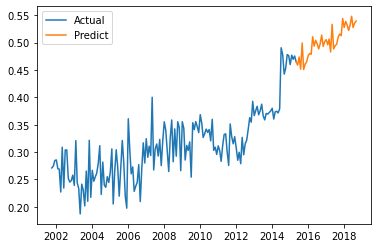

In [42]:
plt.plot(pos_pp,label="Actual")
plt.plot(pp_pred,label="Predict")
plt.legend();

In [43]:
from sklearn.metrics import mean_squared_error
pos_mse = mean_squared_error(pp_pred,po_tst)
print("Positive mse",pos_mse)
print("Positive rmse",np.sqrt(pos_mse))

Positive mse 0.002057215681103429
Positive rmse 0.045356539562707264


# Negative Sentiment Time Series Analysis

In [44]:
neg_df=negative[['polarity']]
neg_df

,polarity
reviewTime,
2018-04-19,-0.266667
2018-04-19,-0.150000
2018-04-07,-0.106250
2018-01-23,-0.083333
2017-10-16,-0.120833
...,...
2014-11-08,-0.130556
2017-10-19,-0.500000
2016-12-06,-0.133333


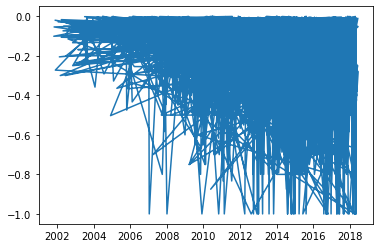

In [45]:
plt.plot(neg_df);

In [46]:
neg_df= neg_df.resample('MS').mean()
neg_df.isnull().sum()

polarity    8
dtype: int64

In [47]:
neg_df["polarity"] = neg_df["polarity"].interpolate(option='spline')
neg_df.isnull().sum()

polarity    0
dtype: int64

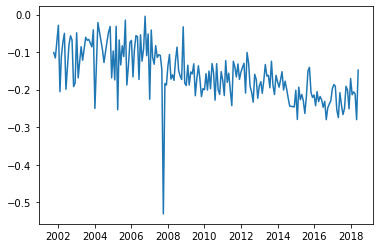

In [48]:
plt.plot(neg_df);

In [49]:
check_data(neg_df)

pvalue 0.7831652222735044


'Data is not stationary'

In [50]:
for i in range(1,5):
    x = neg_df-neg_df.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 8.927752865928964e-08
Shift value 1 Data is stationary


In [51]:
# Decomposition plot for predicted data using Features
decomposition_p=seasonal_decompose((neg_df), period=12)
trend=decomposition_p.trend
seasonal=decomposition_p.seasonal
residual=decomposition_p.resid

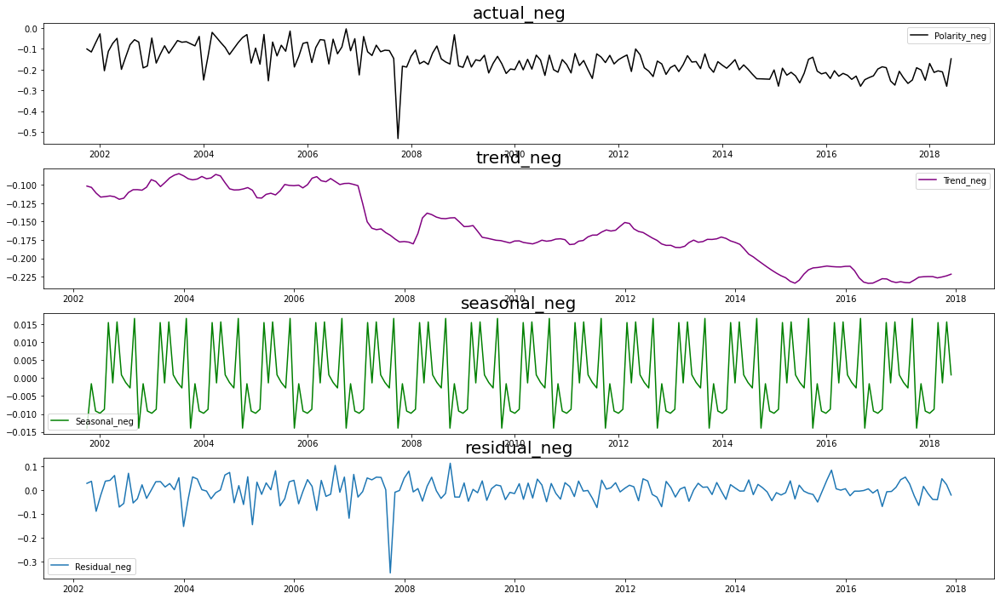

In [52]:
ig,ax = plt.subplots(4,1,figsize=(20,12))

plt.subplot(411)
plt.plot(neg_df,label='Polarity_neg',c='black')
plt.legend()
plt.title('actual_neg', fontsize = 20)

plt.subplot(412)
plt.plot(trend,label='Trend_neg',c='purple')
plt.legend()
plt.title('trend_neg', fontsize = 20)

plt.subplot(413)
plt.plot(seasonal,label='Seasonal_neg',c='green')
plt.legend()
plt.title('seasonal_neg', fontsize = 20)

plt.subplot(414)
plt.plot(residual,label='Residual_neg')
plt.legend()
plt.title('residual_neg', fontsize = 20)
plt.show()

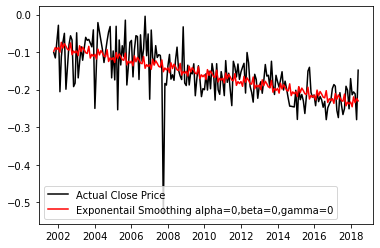

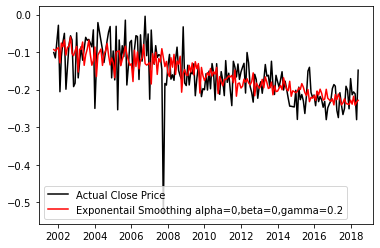

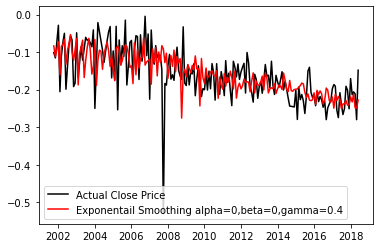

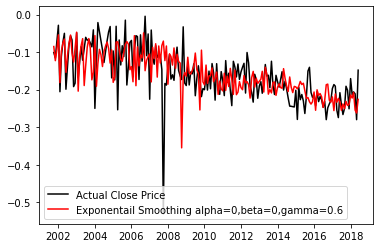

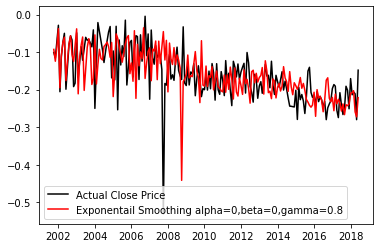

...

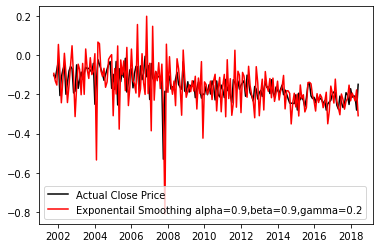

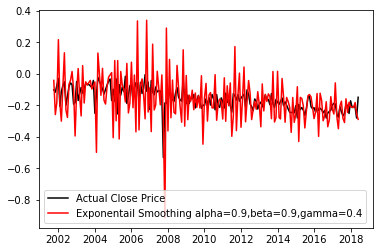

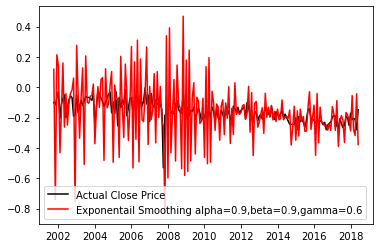

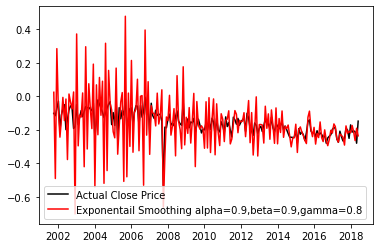

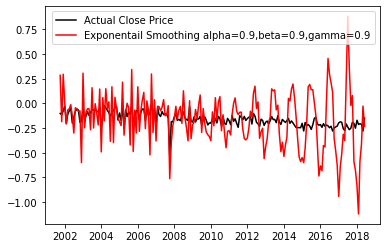

In [53]:
for alpha in [0,0.2,0.4,0.6,0.8,0.9]:
    for beta in [0,0.2,0.4,0.6,0.8,0.9]:
        for gamma in [0,0.2,0.4,0.6,0.8,0.9]:
            model = ExponentialSmoothing(neg_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
            plt.plot(neg_df,color='black',label="Actual Close Price")
            plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
            plt.legend()
            plt.show();

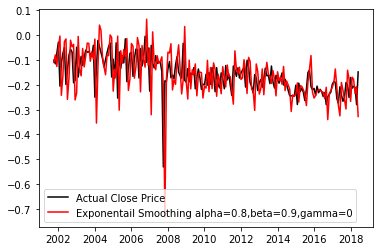

In [54]:
alpha = 0.8
bete = 0.4
gamma = 0
model = ExponentialSmoothing(neg_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
plt.plot(neg_df,color='black',label="Actual Close Price")
plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
plt.legend()
plt.show();

In [55]:
sx = model.forecast(60)
dd = neg_df["polarity"].append(sx[0:1])

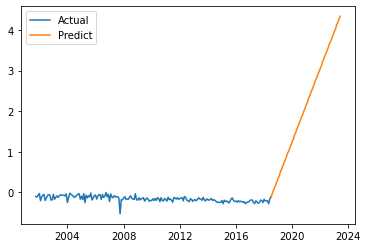

In [56]:
plt.plot(dd,label="Actual")
plt.plot(sx,label="Predict")
plt.legend();

In [57]:
check_data(model.fittedvalues)

pvalue 0.5876678355861291


'Data is not stationary'

In [58]:
for i in range(1,5):
    x = model.fittedvalues-model.fittedvalues.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 4.92062001488689e-08
Shift value 1 Data is stationary


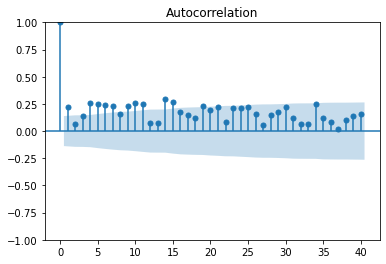

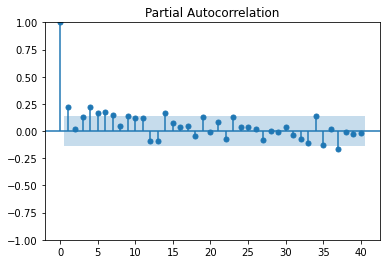

In [59]:
plot_acf(model.fittedvalues,lags=40)
plot_pacf(model.fittedvalues,lags=40);

In [60]:
for q in range(1,9):
    for p in range(1,7):
        mod = sm.tsa.statespace.SARIMAX(model.fittedvalues,order=(p,1,q),seasonal_order=None).fit()
        print("for ", p , q, mod.aic)

for  1 1 -415.3524086809194
for  2 1 -421.4644354623217
for  3 1 -422.59831720218455
for  4 1 -420.6363668301972
for  5 1 -418.7213418012996
for  6 1 -416.8109295564169
for  1 2 -414.16634940001995
for  2 2 -422.222669998843
for  3 2 -420.6495910760119
for  4 2 -418.9859028721214
for  5 2 -416.6525052057897
for  6 2 -414.7997341367318
for  1 3 -421.06738272044447
for  2 3 -420.5782468596387
for  3 3 -418.68059857653736
for  4 3 -416.8245164134082
for  5 3 -415.523853709233
for  6 3 -417.9791257977756
for  1 4 -420.34231285820454
for  2 4 -418.5435220425255
for  3 4 -416.6927380640942
for  4 4 -414.81287762900763
for  5 4 -413.0705311329175
for  6 4 -411.2966999682799
for  1 5 -418.62345582490593
for  2 5 -427.3961373652817
for  3 5 -410.83698072675884
for  4 5 -415.2461079943944
for  5 5 -411.3907637129041
for  6 5 -409.75329748870666
for  1 6 -416.73617645801295
for  2 6 -416.99447020269196
for  3 6 -413.7115265537347
for  4 6 -412.37381836793645
for  5 6 -411.66445122719483
for  6 6 

In [61]:
n_num = int(0.8*len(model.fittedvalues))
neg_trn = neg_df[:n_num]
neg_tst = neg_df[n_num:]


In [62]:
negs_mod = sm.tsa.statespace.SARIMAX(neg_trn,order=(6,1,5),seasonal_order=(1,1,1,20)).fit()
nn_model = negs_mod.fittedvalues
print(negs_mod.summary())

                                      SARIMAX Results                                       
Dep. Variable:                             polarity   No. Observations:                  160
Model:             SARIMAX(6, 1, 5)x(1, 1, [1], 20)   Log Likelihood                 176.651
Date:                              Mon, 03 Apr 2023   AIC                           -325.303
Time:                                      09:47:38   BIC                           -284.220
Sample:                                  10-01-2001   HQIC                          -308.608
                                       - 01-01-2015                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.1668    179.830     -0.006      0.995    -353.628     351.294
ar.L2         -0.00

In [63]:
pvalue = sm.stats.acorr_ljungbox(negs_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.24645898]
FAILED to Reject H0.Good MODEL


In [64]:
nn_str = len(neg_trn)
nn_end = len(neg_trn)+len(neg_tst)-1

In [65]:
ng_pred = negs_mod.forecast(60)

In [66]:
nn_pred = negs_mod.predict(nn_str,nn_end)
nnd = neg_trn["polarity"].append(nn_pred[0:1])

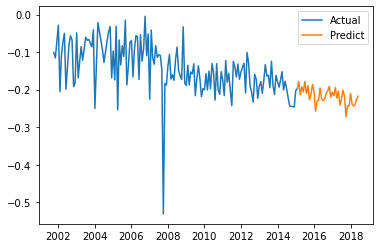

In [67]:
plt.plot(nnd,label="Actual")
plt.plot(nn_pred,label="Predict")
plt.legend();

In [68]:
ndf_sarima_res = pd.DataFrame({"Predictions":nn_pred})
ndf_sarima_res["Actual"] = neg_tst
ndf_sarima_res["err"] = ndf_sarima_res["Actual"]-ndf_sarima_res["Predictions"]

ndf_sarima_res

,Predictions,Actual,err
2015-02-01,-0.198188,-0.279446,-0.081257
2015-03-01,-0.178105,-0.193339,-0.015234
2015-04-01,-0.213492,-0.226775,-0.013283
2015-05-01,-0.192146,-0.212995,-0.020848
2015-06-01,-0.205851,-0.230114,-0.024263
2015-07-01,-0.178618,-0.263558,-0.084940
2015-08-01,-0.210272,-0.217620,-0.007349
2015-09-01,-0.189551,-0.150551,0.039000
2015-10-01,-0.227050,-0.140505,0.086544
2015-11-01,-0.212674,-0.207360,0.005314


In [69]:
neg_mse = mean_squared_error(nn_pred,neg_tst)
print("Negative mse",neg_mse)
print("Negative rmse",np.sqrt(neg_mse))

Negative mse 0.0017300971807173973
Negative rmse 0.04159443689626532


In [70]:
import plotly.express as px
import plotly.graph_objects as go

In [71]:
x = pos_pp .index
y = pos_pp .values
trace1 = go.Scatter(x=x,y=y,name="Pervious Trend of Positive Reviews")
x1 = ss.index
y1 = ss.values
trace2 = go.Scatter(x=x1,y=y1,name="Forecasted Trend of Positive Reviews")

data = [trace1,trace2]
layout = go.Layout(title = "Magzine Subsciption Rview Data",yaxis=dict(title="Polarity score",zeroline=True,showline=True),
                  xaxis = dict(title = "Year"))

fig = go.Figure(data=data,layout=layout)
fig.show()

# in chart to visualize the trend of forcasting positive reviews for the "Magzine Subscription " dataset

In [72]:
x = nnd.index
y = nnd.values
trace1 = go.Scatter(x=x,y=y,name="Pervious trend of Negative Reviews")
x1 = ng_pred.index
y1 = ng_pred.values
trace2 = go.Scatter(x=x1,y=y1,name="Forecasted Future trend of Negative Reviews")

data = [trace1,trace2]
layout = go.Layout(title = "Magzine Subsciption Rview Data",yaxis=dict(title="Polarity Score",zeroline=True,showline=True),
                  xaxis = dict(title = "Year"))

fig = go.Figure(data=data,layout=layout)
fig.show()

# in chart to visualize the trend of forcasting negative reviews for the "Magzine Subscription " dataset